<center><img src='./Figs/cs-logo.png' width=200></center>



<h6><center></center></h6>

<h1>
<hr style=" border:none; height:3px;">
<center>Projet : Detection de point de fuite dans une image de route </center>
<hr style=" border:none; height:3px;">
</h1>


## Qu'est-ce qu'un point de fuite?

La détection de points de fuite consiste à repérer le point où les lignes de la route semblent converger dans une image. C'est essentiel pour des applications telles que la navigation assistée et les systèmes d'aide à la conduite, ainsi que pour créer des modèles 3D à partir d'images. 

Ce projet a pour objectif de concevoir un algorithme capable d'identifier ces points de fuite de manière efficace, même face à des variations importantes dans les images de routes, afin de garantir une détection précise dans différentes conditions.

## Avant propos

Dans ce notebook, nous allons utiliser six differentes images pour tester des méthodes d'identification de ces points de fuites.

# 1 - Visualisation des images 

In [1]:
%matplotlib inline
import numpy as np
from matplotlib import pyplot as plt
import cv2

def loadImage(src):
    img=cv2.imread(src,1)
    rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(rgb,interpolation='nearest')
    plt.show()
    return rgb

## 1.1 - Image 1

Image 1 est l'image d'une simple route droite, sans deviation ou obstacles

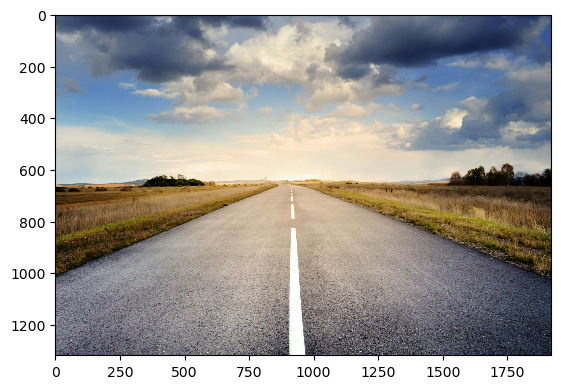

In [2]:
img1=loadImage('./Images/simple_road.jpg')

## 1.2 - Image 2

Image 2 est l'image d'une route ondulée, sans obstacles

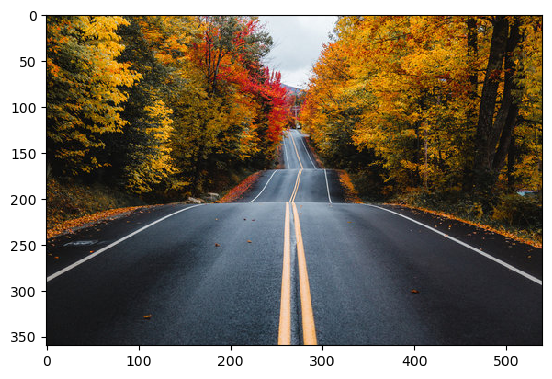

In [3]:
img2=loadImage('./Images/curved_road.jpg')

## 1.3 - Image 3 

Image 3 est l'image d'une simple route droite, sans deviation mais avec une montagne en face, ce qui devrait ajouter un peu de difficulté,

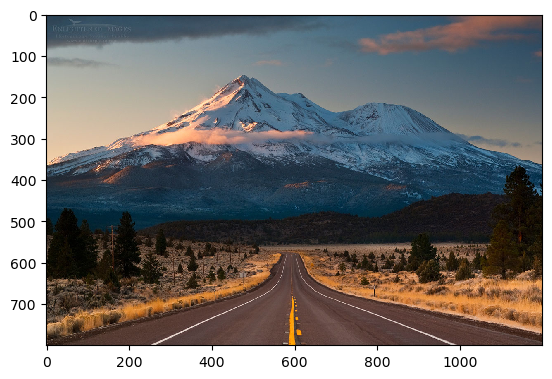

In [4]:
img3=loadImage('./Images/mountain_road.jpg')

## 1.4 - Image 4

Image 4 est l'image d'une route droite, sans deviation mais avec un passage piéton et même des voitures garrées sur les côtés, ce qui va ajouter plus de lignes à prendre en compte.

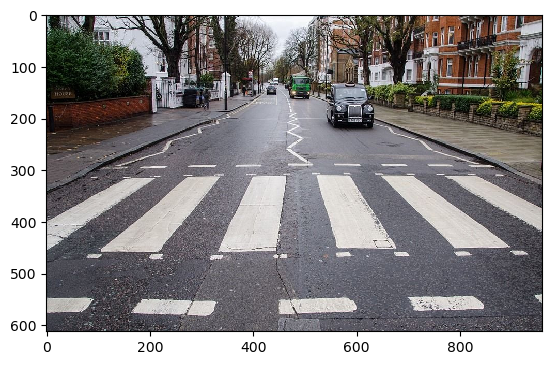

In [5]:
img4=loadImage('./Images/pedestrian_crossing.jpg')

## 1.5 - Image 5

Image 5 est l'image d'une route en plein milieu de New York, avec des immeubles de part et d'autre.

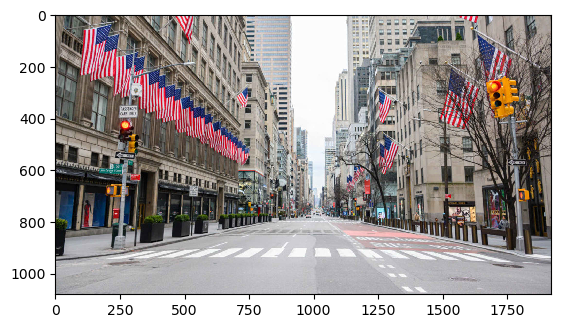

In [6]:
img5=loadImage('./Images/new_york.jpg')

## 1.1 - Image 6

Finalement, l'image 6 est l'image d'une rue similaire à New York mais remplie de gens.

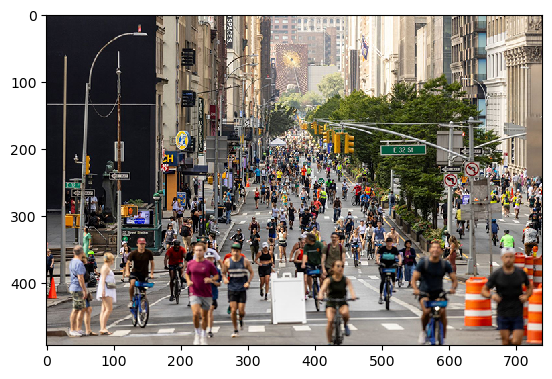

In [7]:
img6=loadImage('./Images/new_york_crowd.jpg')

# 2 - Detection de lignes

La fonction suivante, "detect_lines", prend en entrée le chemin d'une image. Elle lit d'abord l'image à partir du chemin spécifié, la convertit ensuite en niveaux de gris, puis détecte les segments de lignes dans l'image à l'aide de l'algorithme LSD (Line Segment Detector) de OpenCV.

Ensuite, elle convertit l'image en niveaux de gris en une image RGB pour l'affichage en superposant les lignes détectées en vert.

En sortie elle retourne gris qui est est l'image en niveaux de gris, image_avec_lignes qui est l'image avec les lignes en vert visibles dessus et lignes_std qui sont les lignes identifiées.

In [26]:
def detect_lines(image_path):
    # Lire l'image
    image = cv2.imread(image_path)
    if image is None:
        print("Erreur : Impossible de lire l'image.")
        return None

    # Convertir l'image en niveaux de gris
    gris = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Créer un objet OpenCV pour la détection des segments de lignes
    lignes_std = cv2.createLineSegmentDetector(cv2.LSD_REFINE_STD).detect(gris)[0]

    # Convertir l'image en RGB pour l'affichage
    image_avec_lignes = cv2.cvtColor(gris, cv2.COLOR_GRAY2RGB)
    for ligne in lignes_std:
        x1, y1, x2, y2 = map(int, ligne.flatten())
        cv2.line(image_avec_lignes, (x1, y1), (x2, y2), (0, 255, 0), 1)

        
    return gris, image_avec_lignes, lignes_std


# 2.1 - Visualisation

Essayons tout d'abord de visualiser l'image 1 en utilisant cette technique.

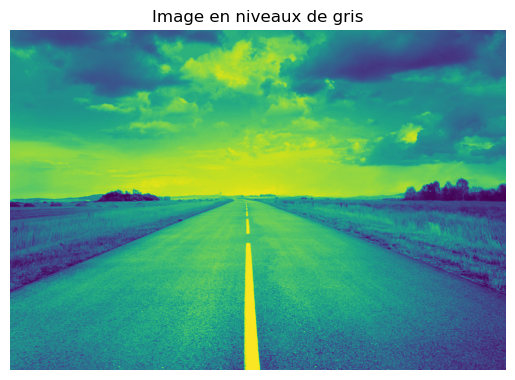

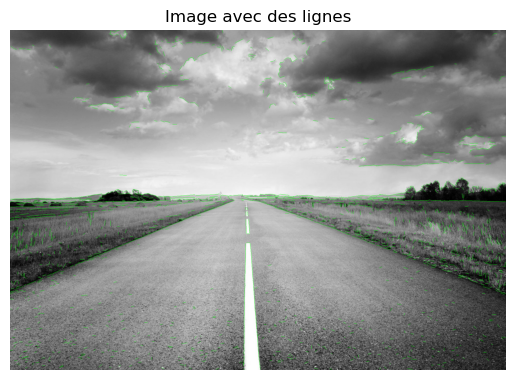

In [27]:
gris, image_avec_lignes, lignes_std = detect_lines('./Images/simple_road.jpg')

plt.imshow(gris)
plt.title('Image en niveaux de gris')
plt.axis('off')
plt.show()

plt.imshow(image_avec_lignes)
plt.title('Image avec des lignes')
plt.axis('off')
plt.show()

Les lignes sembles en effet delimiter la route en question, cepandant on peur remarquer qu'un grand nombre de lignes a été identifié, (dans le gazon et les nuages). Cela pourrait affecter le travail donc il serait mieux de filtrer ces lignes.

# 2.2 - Filtrages des lignes

Ajoutons une fonction is_valid_line. Cette fonction vérifie si une ligne détectée est valide ou non. Elle prend en entrée une ligne sous la forme d'une liste de quatre nombres représentant les coordonnées des points de début et de fin de la ligne.

Elle vérifie d'abord si la ligne est presque verticale en comparant les coordonnées des points de début et de fin. Si la différence est inférieure à 10 pixels dans l'une des directions verticales, la ligne est considérée comme presque verticale et est ignorée.

Ensuite, elle calcule la longueur de la ligne en calculant la distance euclidienne entre les points de début et de fin. Si la longueur de la ligne est inférieure à la longueur minimale spécifiée (20 par défaut), la ligne est considérée comme trop courte et est ignorée.

Elle renvoie True si la ligne est valide et False sinon.

In [28]:
def is_valid_line(ligne, longueur_minimale=20):
    # Ignorer les lignes presque verticales
    if abs(ligne[0][0] - ligne[0][2]) < 10 or abs(ligne[0][1] - ligne[0][3]) < 10:
        return False
    # Ignorer les lignes plus courtes que la longueur minimale
    longueur_carree = (ligne[0][0] - ligne[0][2])**2 + (ligne[0][1] - ligne[0][3])**2
    if longueur_carree < longueur_minimale:
        return False
    return True

Réécrivons maintenant la fonction detect_lines pour inclure ce filtrage de lignes.

In [18]:
def detect_lines(image_path):
    # Lire l'image
    image = cv2.imread(image_path)
    if image is None:
        print("Erreur : Impossible de lire l'image.")
        return None

    # Convertir l'image en niveaux de gris
    gris = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Créer un objet OpenCV pour la détection des segments de lignes
    lignes_std = cv2.createLineSegmentDetector(cv2.LSD_REFINE_STD).detect(gris)[0]
    
    # Filtrer les lignes en fonction de l'angle et de la longueur
    lignes_std = [ligne for ligne in lignes_std if is_valid_line(ligne)]

    # Convertir l'image en RGB pour l'affichage
    image_avec_lignes = cv2.cvtColor(gris, cv2.COLOR_GRAY2RGB)
    for ligne in lignes_std:
        x1, y1, x2, y2 = map(int, ligne.flatten())
        cv2.line(image_avec_lignes, (x1, y1), (x2, y2), (0, 255, 0), 1)

        
    return gris, image_avec_lignes, lignes_std


Maintenant visualisons de nouveau l'image 1.

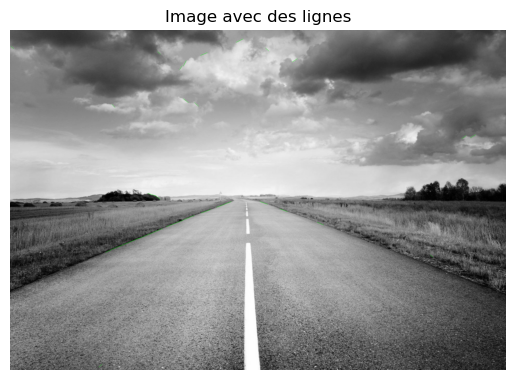

In [30]:
gris, image_avec_lignes, lignes_std = detect_lines('./Images/simple_road.jpg')

plt.imshow(image_avec_lignes)
plt.title('Image avec des lignes')
plt.axis('off')
plt.show()

Le résultat est comme attendu, le nombre de lignes detectées a grandement diminué. Il est possible que trop de lignes ont été filtrées, dans ce cas, on pourra rechanger les valeurs utilisées pour le filtrage des lignes.

# 3 - Point de fuite, premier essai

Avec nos lignes identifiées, il est temps de trouver le point de fuite.

# 3.1 - Intersection des lignes

Commençons tout d’abord par une fonction qui permet de trouver les intersections entre les lignes. Ces intersections nous permettrons par la suite de trouver le point de fuite.

La fonction "find_intersection" prend en entrée deux lignes représentées par des tableaux de quatre coordonnées, chacune représentant les coordonnées des points de début et de fin de la ligne.

Elle calcule d'abord le déterminant en utilisant la formule du produit croisé pour déterminer si les deux lignes sont parallèles ou non. Si le déterminant est différent de zéro, cela signifie que les lignes ne sont pas parallèles, donc elle calcule le point d'intersection en utilisant les formules d'interpolation.

Si les lignes sont parallèles, le code renvoie None, indiquant qu'il n'y a pas de point d'intersection.

In [10]:
def find_intersection(ligne1, ligne2):
    # Extraire les coordonnées des lignes
    x1, y1, x2, y2 = ligne1.flatten()
    x3, y3, x4, y4 = ligne2.flatten()

    # Calculer les déterminants
    d = (x1 - x2) * (y3 - y4) - (y1 - y2) * (x3 - x4)

    # Si les lignes ne sont pas parallèles
    if d != 0:
        # Calculer le point d'intersection
        intersection_x = ((x1 * y2 - y1 * x2) * (x3 - x4) - (x1 - x2) * (x3 * y4 - y3 * x4)) / d
        intersection_y = ((x1 * y2 - y1 * x2) * (y3 - y4) - (y1 - y2) * (x3 * y4 - y3 * x4)) / d
        return intersection_x, intersection_y
    else:
        return None

# 3.2 - Meilleure intersection

Il faut maintenant trouver la meilleur intersection qui sera notre point de fuite.

La fonction find_vanishing_point prend en entrée une liste de lignes détectées dans une image. Elle initialise ensuite deux variables, best_point et min_error.

Ensuite, elle parcourt toutes les paires possibles de lignes dans la liste et trouve le point d'intersection de chaque paire en utilisant la fonction find_intersection. Si un point d'intersection est trouvé, on calcule l'erreur associée à ce point en utilisant la fonction calculate_error. Cette dernière devra être codée ultérieurement. 

elle met à jour le best_point avec le point d'intersection ayant l'erreur minimale trouvée jusqu'à présent. Après avoir parcouru toutes les paires de lignes, elle renvoie le best_point, qui représente le point de fuite estimé dans l'image.

In [11]:
def find_vanishing_point(lignes_std):
    # Initialiser les variables
    best_point = None
    min_error = float('inf')

    # Parcourir les paires de lignes et trouver le point d'intersection
    for i in range(len(lignes_std)):
        for j in range(i + 1, len(lignes_std)):
            ligne1 = lignes_std[i]
            ligne2 = lignes_std[j]
            intersection = find_intersection(ligne1, ligne2)
            if intersection is not None:
                error = calculate_error(intersection, lignes_std)
                if error < min_error:
                    min_error = error
                    best_point = intersection

    return best_point

Codons a présent la fonction calculate_error.

Cette fonction prend en entrée un point et une liste de lignes détectées dans une image. Elle calcule ensuite l'erreur associée à ce point en mesurant la distance de ce point à chacune des lignes dans la liste.

Pour chaque ligne dans la liste lines_std, la fonction calcule la distance entre la ligne et le point en utilisant la formule de la distance entre un point et une ligne. Cette formule implique la distance entre le point et la ligne, en considérant la position du point par rapport à la ligne et les coordonnées des points définissant la ligne.

Ensuite, elle divise cette distance par la longueur de la ligne pour normaliser l'erreur. Cela garantit que l'erreur est indépendante de la longueur de la ligne.

La fonction retourne ensuite la somme de toutes les erreurs calculées, fournissant ainsi une mesure globale de l'erreur pour le point par rapport à toutes les lignes dans l'image.

In [12]:
def calculate_error(point, lignes_std):
    # Calculer l'erreur (distance) de chaque ligne par rapport au point
    errors = [abs((ligne[0][1] - ligne[0][3]) * point[0] + (ligne[0][2] - ligne[0][0]) * point[1] +
                  ligne[0][0] * ligne[0][3] - ligne[0][2] * ligne[0][1]) /
              np.sqrt((ligne[0][1] - ligne[0][3])**2 + (ligne[0][2] - ligne[0][0])**2) for ligne in lignes_std]
    # Retourner la somme des erreurs
    return sum(errors)

# 3.3 Point de fuite obtenu

Ecrivons tout d'abord une fonction process image, qui fait appel à toutes les fonctions précédentes.

In [13]:
def process_image(image_path):
    # Détecter les lignes dans l'image
    gris, image_avec_lignes, lignes_std = detect_lines(image_path)
    
    # Trouver le point de fuite
    vanishing_point = find_vanishing_point(lignes_std)

    # Dessiner le point de fuite sur l'image
    if vanishing_point is not None:
        cv2.circle(image_avec_lignes, (int(vanishing_point[0]), int(vanishing_point[1])), 5, (0, 0, 255), -1)

    # Afficher l'image avec les lignes détectées et le point de fuite
    plt.imshow(image_avec_lignes)
    plt.title('Image avec lignes détectées et le point de fuite')
    plt.axis('off')
    plt.show()

# 3.3.1 - Image 1

Commençons tout d’abord par l’image 1.

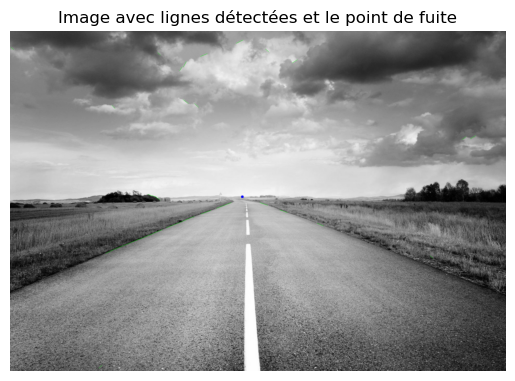

In [37]:
process_image('./Images/simple_road.jpg')

Le point de fuite détecté est assez satisfaisant à l’œil nu. Bien sûr, l’image 1 est la moins compliquée, il faudra voir avec les autres avants juger.

# 3.3.2 - Image 2

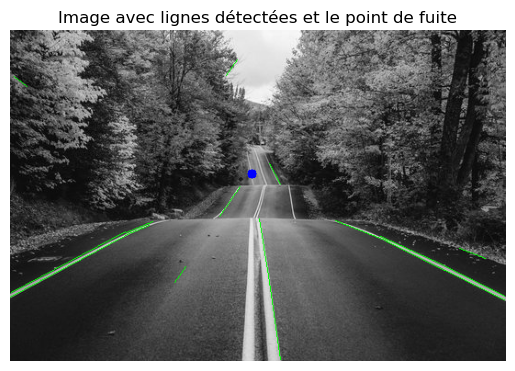

In [40]:
process_image('./Images/curved_road.jpg')

On est encore à la deuxième image et le point de fuite n’est pas optimal. Par contre ce résultat est compréhensible vu la forme de la route. Cette dernière peut être en effet découpée en trois parties, avec la troisième, qui est la plus loin, semblant converger vers les deux autres. En pratique, il est bon que le point de fuite soit bien sur la route. En conduisant, si on s’approche plus de lui, il est possible que ce dernier soit mis à jour avant même qu’on ne l’atteigne. Dans ce cas une solution serait de seulement considerer les lignes les plus proches de la caméra, mais cela nous donnera aussi un point de fuite trop proche ce qui n'est pas optimal pour un conducteur par example avec un certain temps de réaction.

# 3.3.3 -  Image 3

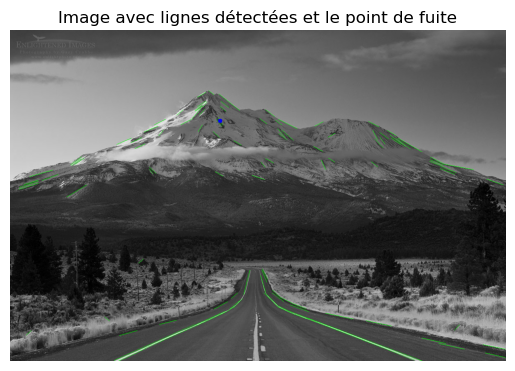

In [41]:
process_image('./Images/mountain_road.jpg')

Pour cette image, le point choisit est clairement mauvais. Les lignes de la montagne sont la cause principale de ce mauvais placement. La solution la plus évidente est de segmenter l’image. Ceci va être notre prochaine étape mais après avoir visualisé les points de fuite des autres images.

# 3.3.4 - Image 4

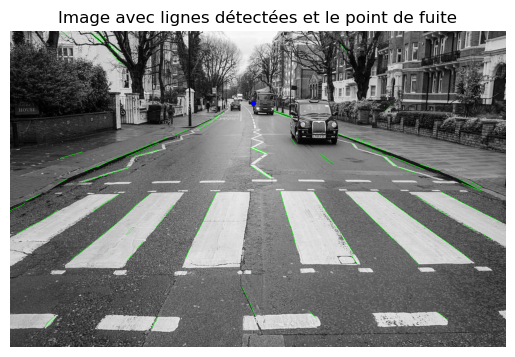

In [42]:
process_image('./Images/pedestrian_crossing.jpg')

Pour cette image le résultat est relativement bon. En effet, bien qu’il y ait plus d’objets (voitures, maisons, arbres, et surtout le passage piéton), ces derniers suivent la direction de la route ce qui n’affecte alors pas beaucoup la détection des points d’intersection, contrairement aux deux cas précédant.

# 3.3.5 - Image 5

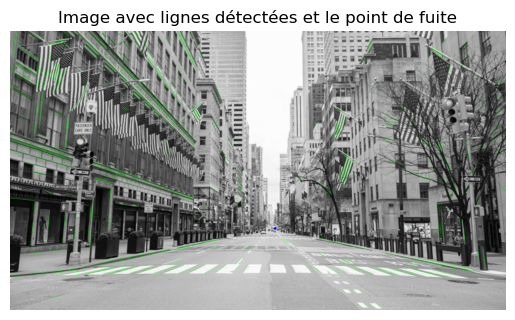

Temps d'exécution: 651.2110197544098 secondes


In [44]:
import time

start_time = time.time()
process_image('./Images/new_york.jpg')
end_time = time.time()

execution_time = end_time - start_time
print("Temps d'exécution:", execution_time, "secondes")


Dans ce cas la détection du point est assez précise, cependant le problème est le temp d’exécution. Contrairement aux autres images qui ont prises aux plus quelque secondes, cette dernière a eu besoin de plus de 10 minutes . Cela pourrait être expliqué par le grand nombre d’objet identifies dans l’image, donc le grand nombre de lignes. Une solution serait de revenir a la fonction is_valid_line, et de filtrer encore plus les lignes en ne gardant que les plus longues, qui devraient être celle de la route. Une longe durée pour la détection du point de fuite réduirait les utilisations possibles de ce projet, puisque sur la route, un temp de réponse rapide est demande de la part du conducteur. Une autre explication pour ce problème de temps, serait notre fonction qui effectue une recherche exhaustive de tous les points d’intersection dans l’image.

# 3.3.6 - Image 6

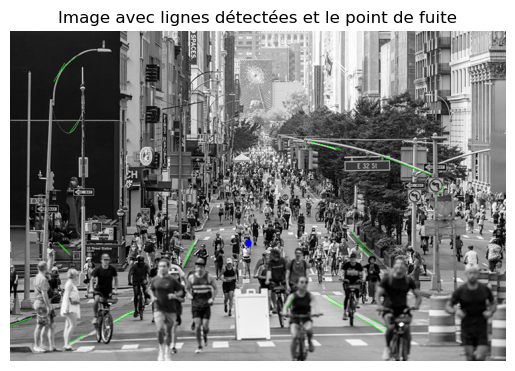

Temps d'exécution: 0.28109145164489746 secondes


In [46]:
start_time = time.time()
process_image('./Images/new_york_crowd.jpg')
end_time = time.time()

execution_time = end_time - start_time
print("Temps d'exécution:", execution_time, "secondes")

Bien que cette image contienne bien plus d’objet (coureurs), elle a pris beaucoup moins de temp que l’image précédant. Cela voudrait dire que la fonction is_valid_line a filtré un grand nombre de lignes initialement trouvées. Par contre, le placement du point de fuite n’est pas optimal. Cependant, comme dit précédemment, tant que le point est correctement placé au milieu de la route, il sera mis a jour plus on s’approche de lui.

# 4 - Segmentation 

Les résultats trouvés jusqu’à maintenant sont bons, mais pourraient être améliorés, en particulier celui de l’image avec une montagne (image 3). 

Par la suite on va se baser sur les notions de segmentation vues dans le TD6 du cours.

# 4.1 - Caractéristiques de couleur

Une manière de caractériser un pixel est vue dans le TD6. Le principe est d'utiliser la valeur de la couleur en chaque pixel pour le caractériser.

La fonction color_features, prend une image en entrée et génère des caractéristiques (features) basées sur la couleur des pixels de l'image.

Elle commence par obtenir les dimensions de l'image H (hauteur), W (largeur) et C (nombre de canaux de couleur). Ensuite, elle normalise les valeurs des pixels de l'image pour les ramener dans la plage [0, 1].

Ensuite, elle crée une matrice de caractéristiques features de dimensions (H*W, C), où chaque ligne représente un pixel de l'image et chaque colonne représente la valeur de chaque canal de couleur pour ce pixel.

Enfin, elle retourne cette matrice de caractéristiques, où chaque ligne contient les valeurs normalisées des canaux de couleur pour chaque pixel de l'image.

In [14]:
def color_features(img):
    #Représente un pixel par sa couleur.

    H, W, C = img.shape
    print(H, W, C)
    # Normaliser les valeurs des pixels de l'image dans la plage [0, 1]
    color = cv2.normalize(img, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    features = np.zeros((H*W, C))

    features = color.reshape(H*W, C)

    return features

Visualisons ces caractéristiques pour chaque des images.

In [51]:
print ("caractéristiques de l'image 1:")
features1 = color_features(img1)
features1.dtype

print ("caractéristiques de l'image 2:")
features2 = color_features(img2)
features2.dtype

print ("caractéristiques de l'image 3:")
features3 = color_features(img3)
features3.dtype

print ("caractéristiques de l'image 4:")
features4 = color_features(img4)
features4.dtype

print ("caractéristiques de l'image 5:")
features5 = color_features(img5)
features5.dtype

print ("caractéristiques de l'image 6:")
features6 = color_features(img6)
features6.dtype

caractéristiques de l'image 1:
1318 1920 3
caractéristiques de l'image 2:
360 540 3
caractéristiques de l'image 3:
800 1200 3
caractéristiques de l'image 4:
612 960 3
caractéristiques de l'image 5:
1080 1920 3
caractéristiques de l'image 6:
493 740 3


dtype('float32')

# 4.2 K-means

Maintenant il faut créer une fonction de clustering qui pourra regrouper les pixels de l’image pour notre travail de segmentation. Pour ce nous allons utiliser la fonction K-means, en particulier kmeans-fast vue dans le TD6.

La fonction kmeans_fast implémente l'algorithme de regroupement K-means pour partitionner un ensemble de caractéristiques en un nombre prédéfini de clusters. 

Elle commence par initialiser aléatoirement les centres de ces clusters en sélectionnant aléatoirement des points à partir des caractéristiques fournies. 

Ensuite, elle effectue un processus itératif qui consiste à affecter chaque point au cluster dont le centre est le plus proche, puis à mettre à jour les centres de cluster en recalculant leur position comme la moyenne des points qui leur sont attribués. 

Cette étape est répétée un nombre spécifié de fois ou jusqu'à ce que les centres des clusters ne changent plus de manière significative entre deux itérations successives. 

Une fois la convergence atteinte, la fonction renvoie un tableau contenant les indices des clusters auxquels chaque point est attribué. 

Cette implémentation utilise des fonctionnalités de la bibliothèque NumPy pour accélérer le processus de calcul, ce qui en fait une méthode efficace pour le regroupement de grandes quantités de données.

In [15]:
def kmeans_fast(features, k, num_iters=100):
    """ 
Utilisez l'algorithme k-means pour regrouper les caractéristiques en k clusters.
Cette fonction utilise les fonctions et la diffusion de numpy pour accélérer la première partie 
(affectation des clusters) de l'algorithme k-means.
"""

    N, D = features.shape

    assert N >= k, 'Le nombre de clusters ne peut pas être supérieur au nombre de points.'

    # Initialisez aléatoirement les centres des clusters.
    idxs = np.random.choice(N, size=k, replace=False)
    centers = features[idxs]
    assignments = np.zeros(N)

    for n in range(num_iters):
        f_tmp = np.tile(features, (k, 1))
        c_tmp = np.repeat(centers, N, axis=0)
        assignments = np.argmin(np.sum((f_tmp - c_tmp)**2, axis=1).reshape(k, N), axis=0)
        tmp = centers.copy()
        for j in range(k):
            centers[j] = np.mean(features[assignments == j], axis=0)
        if np.allclose(tmp, centers):
            break

    return assignments


Avec ce, il est finalement possible de faire la segmentation des images. Dans la cellule de code suivante, la version après segmentation de nos 6 images est sauvegardée dans un répertoire à part pour éviter de répéter ce travail lors de l’essai de la détection de point de fuite de ces images dans d’autres Notebooks.

La cellule de code suivante accomplit plusieurs étapes pour segmenter des images à l'aide de l'algorithme K-means et sauvegarder les résultats. 

Tout d'abord, elle définit un répertoire de sortie où les images segmentées seront stockées, et elle crée ce répertoire s'il n'existe pas déjà. 

Des noms de fichiers sont ensuite définis pour les images segmentées, et des chemins complets sont construits en joignant ces noms de fichiers avec le répertoire de sortie. 

Ensuite, la cellule entre dans une boucle qui traite chaque image de la liste fournie. Pour chaque image, elle extrait l'image, calcule ses caractéristiques de couleur, effectue des vérifications de cohérence sur ces caractéristiques, puis utilise l'algorithme K-means pour segmenter l'image en 4 clusters. 

La segmentation est ensuite affichée et l'image segmentée est sauvegardée dans le répertoire de sortie. Enfin, la figure est fermée pour libérer la mémoire après chaque sauvegarde. 

En résumé, cette cellule de code permet de segmenter plusieurs images en utilisant l'algorithme K-means, de visualiser chaque segmentation et de sauvegarder les résultats dans un répertoire spécifié.

1318 1920 3


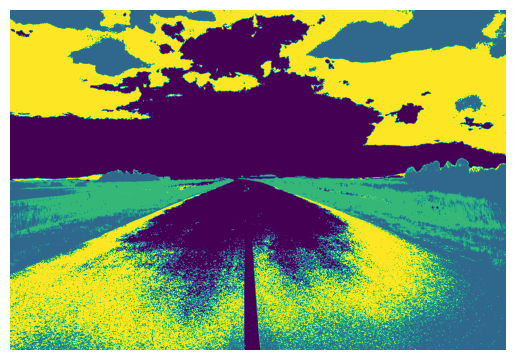

360 540 3


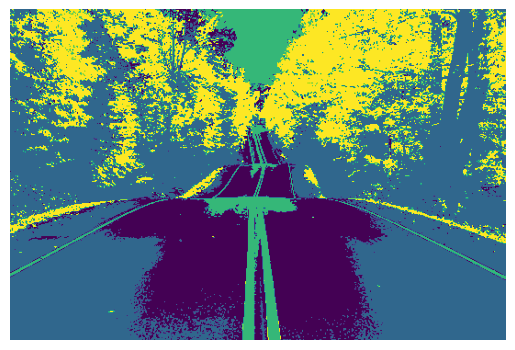

800 1200 3


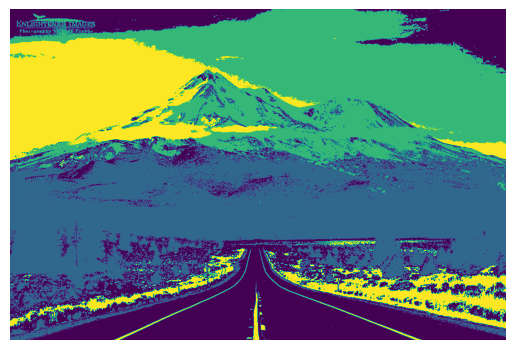

612 960 3


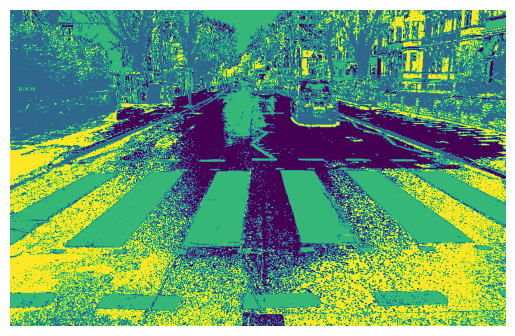

1080 1920 3


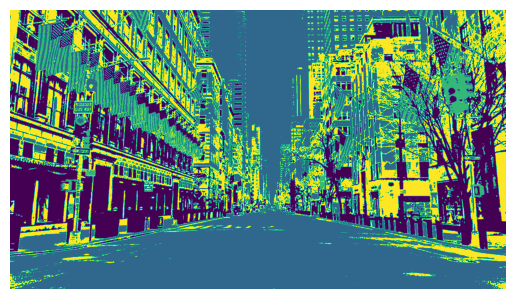

493 740 3


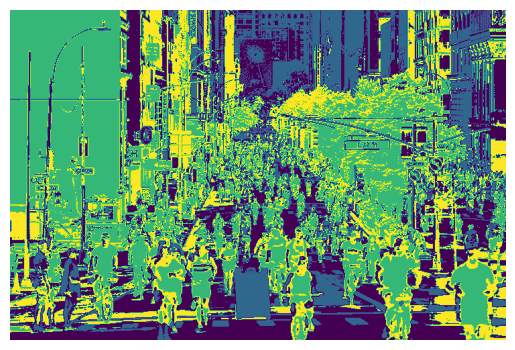

In [62]:
import os

# Définir le répertoire de sortie
output_directory = r".\Images_segm"

# Créer le répertoire s'il n'existe pas
os.makedirs(output_directory, exist_ok=True)

# Définir les noms de fichiers pour les images segmentées
output_filenames = ["segmented_img1.jpg", "segmented_img2.jpg", "segmented_img3.jpg", "segmented_img4.jpg", "segmented_img5.jpg", "segmented_img6.jpg"]

# Construire les chemins de sortie complets
output_paths = [os.path.join(output_directory, filename) for filename in output_filenames]

images = ["img1", "img2", "img3", "img4", "img5", "img6"]

for i in range(len(images)):
    image_name = images[i]
    output_path = output_paths[i]
    img = globals()[image_name]  # Accès aux variables d'image par nom
    
    # Calculer les caractéristiques de couleur
    features = color_features(img)
    
    # Vérifications de cohérence
    H, W, C = img.shape
    assert features.shape == (H * W, C), "Incorrect shape! Check your implementation."
    assert features.dtype == np.float32, "dtype of color_features should be float."
    
    # Effectuer la segmentation
    assignments = kmeans_fast(features, 4)
    segments = assignments.reshape((H, W))
    
    # Afficher la segmentation et enregistrer l'image segmentée
    plt.imshow(segments, cmap='viridis')
    plt.axis('off')
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
    plt.show()
    plt.close()


# 5 - Points de fuite aprés segmentation

Avec la segmentation des images terminée, il est temps de réessayer la detection du point de fuite en utilisant les images segmentées.

# 5.1 - Image 1

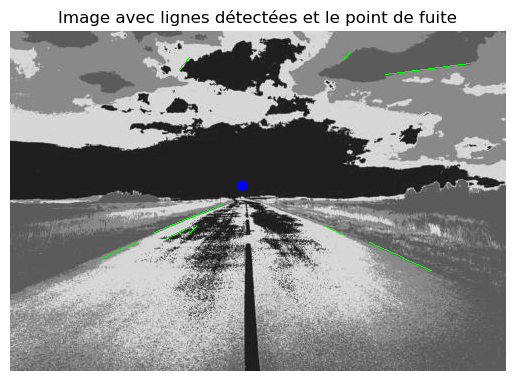

In [32]:
process_image('./Images_segm/segmented_img1.jpg')

Ce point de fuite a été obtenu après plusieurs essai, en changeant à chaque fois le nombre de clusters pour le K-means. Initialement, avec 8 clusters, trop de lignes ont été identifiée, ce qui a conduit a un mauvais point de fuite. Mais avec 4 clusters le résultat n’est pas mauvais. Passons aux images suivantes avant de prononcer le verdict.

# 5.2 - Image 2

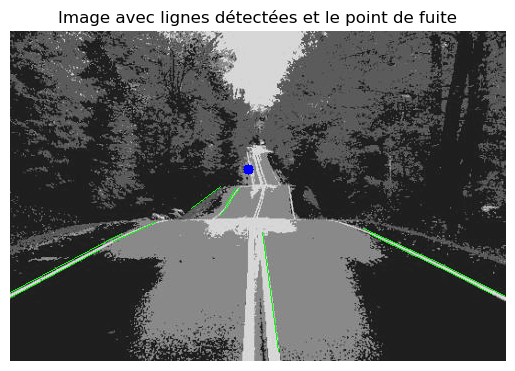

In [33]:
process_image('./Images_segm/segmented_img2.jpg')

Pour cette image, le point de fuite détectée n’a pas grandement changé, c’est le même que dans l’essai avant segmentation. Vu la forme de la route, comme expliqué précédemment, ce point est raisonnable.

# 5.3 - Image 3

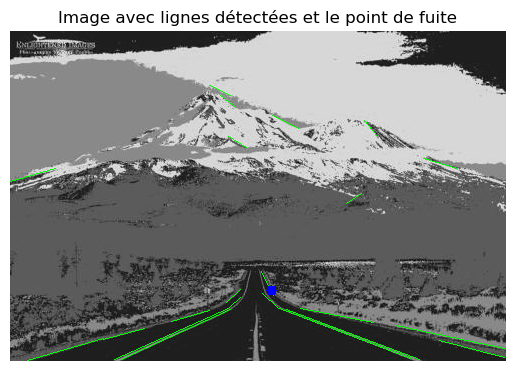

In [55]:
process_image('./Images_segm/segmented_img3.jpg')

Pour cette image le point de fuite est mieux qu’avant mais sur le bord de la route. Essayons avec différents nombre de clusters. Pour ce voici la fonction vp_seg qui fait tout ce que la cellule de code precedante fait mais pour une seule image.

In [58]:
# Définir le répertoire de sortie
output_directory = r".\Images_segm"

# Définir le nom de fichiers pour l'images segmentée
output_filename = "segmented_img3.jpg"

# Construire les chemins de sortie complets
output_path = os.path.join(output_directory, output_filename)

image_name = "img3"

num_clusters = 3

def vp_seg (image_name, num_clusters, output_path):
    img = globals()[image_name]  # Accès aux variables d'image par nom

    # Calculer les caractéristiques de couleur
    features = color_features(img)

    # Vérifications de cohérence
    H, W, C = img.shape
    assert features.shape == (H * W, C), "Incorrect shape! Check your implementation."
    assert features.dtype == np.float32, "dtype of color_features should be float."

    # Effectuer la segmentation
    assignments = kmeans_fast(features, num_clusters)
    segments = assignments.reshape((H, W))

    # Afficher la segmentation et enregistrer l'image segmentée
    plt.imshow(segments, cmap='viridis')
    plt.axis('off')
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0)
    plt.show()
    plt.close()


800 1200 3


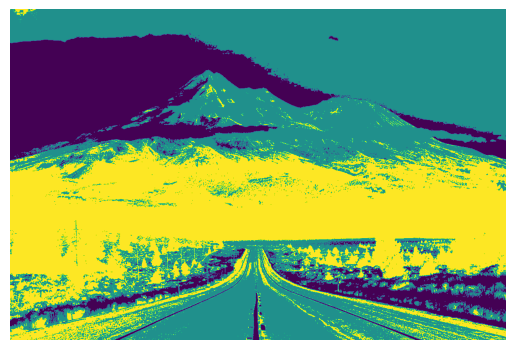

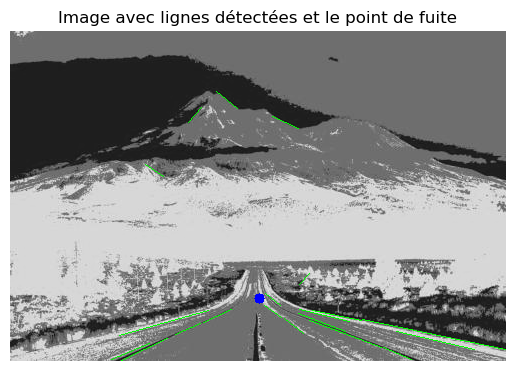

In [48]:
vp_seg(image_name, num_clusters, output_path)
process_image('./Images_segm/segmented_img3.jpg')

Avec un cluster en moins le résultat est déjà beaucoup mieux. Cepandant, il faut notter que le resultat obtenu pourrait grandement changer d'un clustering à l'autre et ce pour un meme nombre de clusters.

# 5.4 - Image 4

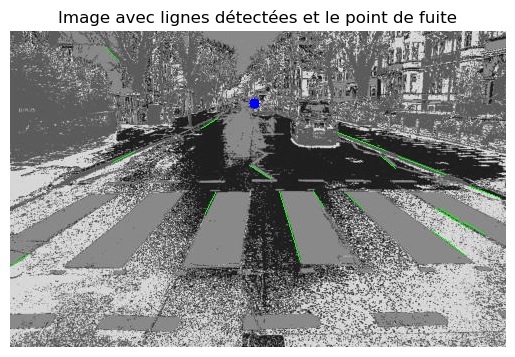

In [63]:
process_image('./Images_segm/segmented_img4.jpg')

Bon résultat similaire à celui avant segmentation.

# 5.5 - Image 5

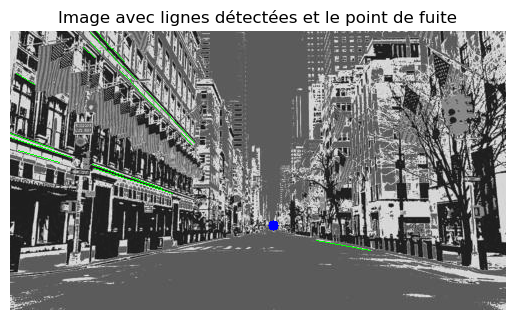

In [64]:
process_image('./Images_segm/segmented_img5.jpg')

Même chose que l’image 4.

# 5.6 - Image 6

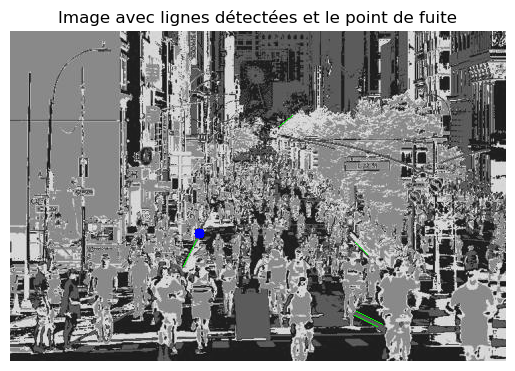

In [65]:
process_image('./Images_segm/segmented_img6.jpg')

Pour cette image, le point de fuite trouvé est un peu plus à la droite que celui avant segmentation. Vu le grand nombre d’objet, cela est raisonnable vu qu’il est au moins sur la route. Il serait possible d’obtenir un meilleur résultat en asseyant différant clusters.

# 6 - Optimisation des lignes

Dans cette partie, nous allons nous interesser à un papier ecrit par Xiaoyun An en 2021 intitulé Vanishing Point Detection based on Line Set Optimization

**Reference** : An, Xiaoyun, et al. "Vanishing Point Detection based on Line Set Optimization." Journal of Physics: Conference Series. Vol. 1748. No. 3. IOP Publishing, 2021.

L'extraction d'algorithmes de ligne est une étape cruciale dans le processus de traitement d'images, car les caractéristiques de lignes droites fournissent des indices importants pour comprendre les informations visuelles. L'algorithme de détection de ligne le plus couramment utilisé est la transformation de Hough, qui présente l'avantage de ne pas être affecté par la rotation de l'image et d'être capable d'effectuer une transformation géométrique rapide des images. Cependant, sa complexité temporelle et spatiale est élevée, et il ne permet de déterminer que la direction de la ligne droite lors du processus de détection, perdant ainsi l'information sur la longueur des segments de ligne. Dans cette étude, l'algorithme LSD (Line Segment Detector) est privilégié pour extraire les lignes droites dans l'image. Contrairement à la transformation de Hough, LSD est un algorithme d'extraction partielle, ce qui le rend plus rapide. Il peut détecter rapidement les segments de lignes droites dans l'image et concevoir ensuite un algorithme rapide en fonction des caractéristiques géométriques de la cible pour déterminer rapidement la zone cible suspectée. De plus, LSD est un algorithme de détection et de segmentation de lignes droites, capable d'obtenir des résultats de détection avec une précision sub-pixel en temps linéaire, sans nécessiter d'ajustement de paramètres sur n'importe quelle image numérique.

L'algorithme d'optimisation de l'ensemble de lignes se concentre sur la correction de la pente d'une ligne droite. Cette correction est nécessaire pour rectifier la pente des lignes droites aux deux extrémités d'objets à double bordure, tels que les cadres de portes, les fenêtres, les poteaux, etc. Une fois que les lignes droites ont été optimisées, certaines peuvent former plusieurs segments de lignes brisées après l'extraction, nécessitant une recalibration et une connexion pour correspondre davantage à la ligne droite réelle.

Ensuite, le processus de clustering de toutes les lignes droites est abordé. L'algorithme de K-means est utilisé pour regrouper les ensembles de lignes optimisées. Cette méthode de clustering est choisie pour sa simplicité, sa facilité de compréhension et sa rapidité. L'algorithme K-means est basé sur le principe de partitionnement, et dans cette étude, il est appliqué en une dimension pour réduire la complexité computationnelle. La définition des centres de cluster et des distances entre les points sont des éléments clés de l'algorithme. En utilisant l'angle entre le segment de ligne droite et la direction positive de l'axe des x, le type de ligne droite peut être déterminé. La sélection initiale des centroides est effectuée de manière aléatoire, et la distance entre le centroïde et la ligne droite est calculée pour le clustering.

La détermination du point de fuite est ensuite abordée, en particulier pour les cas où le nombre de lignes est important et où des données aberrantes peuvent être présentes. L'algorithme RANSAC (Random Sample Consensus) est utilisé pour fournir une solution robuste à ce problème en réduisant l'impact des données aberrantes sur la détection du point de fuite. Contrairement aux méthodes traditionnelles qui utilisent l'ensemble des données pour obtenir une solution initiale, RANSAC utilise un petit sous-ensemble de données et tente de l'élargir en utilisant des données cohérentes autant que possible. Cette approche offre une solution plus rapide et plus résistante aux données aberrantes. En conclusion, ces étapes d'extraction, d'optimisation et de clustering des lignes droites, suivies de la détection du point de fuite, permettent d'obtenir des informations précieuses sur la structure géométrique des images, améliorant ainsi la précision des analyses et des applications de vision par ordinateur.

# 6.1 - Correction de la pente des lignes

La fonction suivante, correct_line_slope, est conçue pour corriger la pente des lignes dans un ensemble de lignes données. Elle prend en entrée deux paramètres : lines, qui représente l'ensemble de lignes à corriger, et threshold_distance, qui définit une distance seuil à laquelle deux lignes sont considérées comme ayant une relation incluse.

La fonction parcourt chaque ligne dans l'ensemble lines et compare ses coordonnées avec celles des autres lignes de l'ensemble pour détecter les lignes qui ont une relation incluse. Si deux lignes sont considérées comme ayant une relation incluse, la fonction calcule la distance entre ces lignes. Si cette distance est inférieure au seuil défini par threshold_distance, la fonction applique une correction de pente à la première ligne en utilisant une équation spécifique (équation 4 du papier). Cette correction est calculée en fonction des coordonnées des extrémités de la deuxième ligne. Ensuite, la fonction applique cette correction de pente à la première ligne en ajustant ses coordonnées pour corriger sa pente.

In [66]:
def correct_line_slope(lines, threshold_distance):
    for line1 in lines:
        x1, y1, x2, y2 = line1[0]  # Accéder au premier élément du tableau de ligne
        for line2 in lines:
            if line1 is not line2:  # S'assurer que nous ne comparons pas la même ligne
                x3, y3, x4, y4 = line2[0]
                # S'assurer que le dénominateur n'est pas nul
                if x4 - x3 != 0:
                    # Calculer la distance entre les deux lignes
                    dist_lines = np.abs((y2 - y1) * x3 - (x2 - x1) * y3 + x2 * y1 - y2 * x1) / np.sqrt((y2 - y1)**2 + (x2 - x1)**2)
                    if dist_lines < threshold_distance:
                        # Calculer la correction de la pente
                        slope_correction = (y4 - y3) / (x4 - x3)
                        # Appliquer la correction
                        line1[0][2] = x2 + slope_correction * (x2 - x1)
                        line1[0][3] = y2 + slope_correction * (y2 - y1)


# 6.2 - Correction des lignes brisées

La fonction connect_broken_lines, est conçue pour relier les segments de lignes brisées dans un ensemble de lignes donné. 

D'après le papier, en raison de l'influence du bruit ou des changements d'éclairage, les lignes droites continues dans le monde réel peuvent se fragmenter en plusieurs courts segments de lignes droites après avoir été extraites par l'algorithme. De plus, ces courts segments de lignes droites peuvent s'écarter de la trajectoire droite originale, et il est nécessaire de les recalibrer et de les connecter afin de les rendre plus conformes à la ligne droite réelle.

Elle prend en entrée deux paramètres : lines, qui représente l'ensemble de lignes à traiter, et threshold_distance, qui définit une distance seuil pour déterminer si deux lignes peuvent être connectées.

La fonction parcourt chaque ligne dans l'ensemble lines et compare les coordonnées de ses extrémités avec celles des autres lignes de l'ensemble pour détecter les lignes dont les extrémités sont proches les unes des autres, c'est-à-dire à une distance inférieure au seuil défini par threshold_distance. Si deux lignes sont suffisamment proches, elles sont fusionnées pour former une seule ligne continue. Cette nouvelle ligne est ajoutée à une liste appelée connected_lines.

Après avoir parcouru toutes les lignes, la fonction ajoute les lignes originales qui n'ont pas été fusionnées à la liste connected_lines. Enfin, la fonction retourne cette liste contenant les lignes initiales ainsi que les lignes connectées.

In [67]:
def connect_broken_lines(lines, threshold_distance):
    connected_lines = []
    for line1 in lines:
        x1, y1, x2, y2 = line1[0]
        for line2 in lines:
            if line1 is not line2:  # S'assurer que nous ne comparons pas la même ligne
                x3, y3, x4, y4 = line2[0]
                # Calculer la distance entre les extrémités de deux lignes.
                dist_endpoints = np.sqrt((x2 - x3)**2 + (y2 - y3)**2)
                # Vérifier si la distance est inférieure au seuil.
                if dist_endpoints < threshold_distance:
                    # Fusionner les deux lignes en une seule.
                    merged_line = np.array([[x1, y1, x4, y4]])
                    connected_lines.append(merged_line)
    # Ajouter les lignes originales qui n'ont pas été fusionnées.
    connected_lines.extend(lines)
    return connected_lines

# 6.3 - Filtrer les lignes trop courtes

Cette fonction, remove_short_lines, vise à éliminer les segments de lignes droites trop courts d'un ensemble de lignes donné. Elle prend deux paramètres en entrée : lines, qui représente l'ensemble de lignes à traiter, et min_length, qui définit la longueur minimale acceptable pour une ligne droite. La fonction parcourt chaque ligne dans l'ensemble lines et vérifie si sa longueur est supérieure ou égale à la longueur minimale spécifiée. Elle retourne ensuite un nouvel ensemble de lignes ne contenant que les lignes dont la longueur est suffisante. La fonction est capable de traiter à la fois les listes Python et les tableaux NumPy en fonction du type d'entrée fourni. Si le type d'entrée n'est ni une liste ni un tableau NumPy, une erreur de type est levée.

In [68]:
def remove_short_lines(lines, min_length):
    # Eliminer les segments de lignes droites trop courtes
    if isinstance(lines, list):
        return [line for line in lines if np.linalg.norm(np.array(line[0][:2]) - np.array(line[0][2:])) >= min_length]
    elif isinstance(lines, np.ndarray):
        return lines[np.linalg.norm(lines[:, :, :2] - lines[:, :, 2:], axis=-1) >= min_length]
    else:
        raise TypeError("Invalid type for lines. Expected list or numpy array.")

# 6.4 - Extraction des lignes

Cette fonction, line_extraction extrait les segments de lignes d'une image en utilisant l'algorithme LSD et formate les lignes détectées.

In [69]:
def line_extraction(image):
    # Utiliser LSD pour détecter les segments de lignes
    lines_std = cv2.createLineSegmentDetector(cv2.LSD_REFINE_STD).detect(image)[0]
    
    # Convertir les lignes_std au format attendu
    formatted_lines = []
    for line in lines_std:
        x1, y1, x2, y2 = map(int, line.flatten())
        formatted_lines.append(np.array([[x1, y1, x2, y2]]))
    
    return formatted_lines

# 6.5 - Simple clustering

La fonction clustering réalise un clustering des lignes en utilisant les angles formés par les lignes et attribue à chaque ligne un label correspondant au cluster auquel elle appartient.

In [71]:
from sklearn.cluster import KMeans

def clustering(lines, num_clusters):
    angles = np.arctan2(lines[:, :, 3] - lines[:, :, 1], lines[:, :, 2] - lines[:, :, 0])
    kmeans = KMeans(n_clusters=num_clusters).fit(angles.reshape(-1, 1))
    return kmeans.labels_

# 6.6 - Point de fuite

La fonction suivante, estimate_vanishing_point, vise à estimer les points de fuite dans une image en utilisant les lignes détectées et les clusters attribués précédemment. Tout d'abord, elle obtient la forme de l'image pour déterminer les limites. Ensuite, elle itère à travers chaque cluster de lignes et ajuste un modèle RANSAC sur les lignes associées. En utilisant le point milieu de l'image comme échantillon, elle prédit le point de fuite correspondant. Si le point prédit est un tableau NumPy, elle s'assure que les coordonnées du point de fuite restent à l'intérieur des limites de l'image. Finalement, elle retourne une liste de points de fuite estimés.

In [74]:
from sklearn.linear_model import RANSACRegressor

def estimate_vanishing_point(lines, labels, image):
    image_shape = image.shape[:2]
    vanishing_points = []
    for label in np.unique(labels):
        subset_lines = lines[labels == label][:, 0, :]
        if len(subset_lines) < 2:  # S'assurer qu'il y ait au moins deux lignes présentes pour RANSAC
            continue
        model = RANSACRegressor().fit(subset_lines[:, :2], subset_lines[:, 2:])
        # Prédire le point de fuite en utilisant le point milieu de l'image comme point d'échantillon
        sample_point = np.array([[image_shape[1] / 2, image_shape[0] / 2]])  # Point milieu de l'image
        predicted_point = model.predict(sample_point)
        if isinstance(predicted_point, np.ndarray):
            vp_x, vp_y = predicted_point.flatten()  # Déballer le point prédit
            # S'assurez-vous que le point de fuite soit à l'intérieur des limites de l'image
            vp_x = max(0, min(vp_x, image_shape[1]))  # Restreindre la coordonnée x à la largeur de l'image
            vp_y = max(0, min(vp_y, image_shape[0]))  # Restreindre la coordonnée y à la hauteur de l'image
        else:
            vp_x = vp_y = predicted_point  # Assigner la valeur unique à la fois à vp_x et vp_y

        vanishing_points.append((vp_x, vp_y))
    return vanishing_points

# 6.7 - Process_image

La fonction process_image lit l'image à partir du chemin spécifié et la convertit en niveaux de gris, une étape préliminaire nécessaire pour simplifier le traitement ultérieur. Ensuite, elle extrait les lignes de l'image en utilisant une méthode de détection des lignes appelée line_extraction, qui utilise l'algorithme de détection des segments de ligne LSD (Line Segment Detector). Ces lignes détectées sont ensuite affichées sur l'image d'origine pour permettre une visualisation des résultats.

Après la détection initiale des lignes, la fonction passe à l'étape de correction et d'optimisation des lignes. Elle corrige d'abord la pente des lignes détectées pour les rendre plus cohérentes et précises. Ensuite, elle connecte les segments de lignes brisées qui peuvent avoir été générés en raison de bruit ou d'autres facteurs perturbateurs. Les lignes trop courtes, qui peuvent être des artefacts de détection indésirables, sont également supprimées pour nettoyer davantage les résultats.

Une fois que les lignes ont été corrigées, optimisées et nettoyées, la fonction procède à la phase de regroupement des lignes. Elle utilise un algorithme de clustering pour regrouper les lignes similaires en un nombre spécifié de clusters, ce qui aide à organiser les lignes en fonction de leurs caractéristiques communes.

Enfin, la fonction estime les points de fuite des lignes détectées, qui sont des points hypothétiques vers lesquels les lignes parallèles semblent converger. Ces points sont estimés à l'aide d'un algorithme RANSAC (Random Sample Consensus), qui permet de détecter les points de fuite même en présence de données aberrantes. Les lignes détectées, ainsi que les points de fuite estimés, sont finalement affichés sur l'image d'origine pour permettre une analyse visuelle des résultats.

In [76]:
def process_image2(image_path):
    # Lire l'image
    image = cv2.imread(image_path)
    if image is None:
        print("Error: Unable to read image.")
        return None

    # Convertion en niveau de gris
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Extraction des lignes
    lines = line_extraction(gray)

    # Visualisation ds lignes detectees
    plt.figure(figsize=(10, 8))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Detected Lines Before Correction')
    for line in lines:
        x1, y1, x2, y2 = line[0]
        plt.plot([x1, x2], [y1, y2], color='green', linewidth=2)
    plt.axis('off')
    plt.show()

    # Line Set Optimization
    correct_line_slope(lines, threshold_distance=10)
    lines = connect_broken_lines(lines, threshold_distance=10)
    lines = remove_short_lines(lines, min_length=20)

    # Visualiser les lignes détectées après correction
    plt.figure(figsize=(10, 8))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Detected Lines After Correction')
    for line in lines:
        x1, y1, x2, y2 = line[0]
        plt.plot([x1, x2], [y1, y2], color='blue', linewidth=2)
    plt.axis('off')
    plt.show()

    # Convertir les lignes en tableau numpy
    lines_np = np.array(lines)

    # Clustering
    num_clusters = 3
    labels = clustering(lines_np, num_clusters)

    # Point de fuite estimé
    vanishing_points = estimate_vanishing_point(lines_np, labels, image)

    # Visualiser les lignes détectées et les points de fuite
    plt.figure(figsize=(10, 8))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Detected Lines with Vanishing Points')
    for line in lines:
        x1, y1, x2, y2 = line[0]
        plt.plot([x1, x2], [y1, y2], color='blue', linewidth=2)
    for point in vanishing_points:
        # S'assurer que le point de fuite est dans les limites de l'image
        vp_x, vp_y = point
        vp_x = max(0, min(vp_x, image.shape[1]))  # Rogner les coordonnées x à la largeur de l'image
        vp_y = max(0, min(vp_y, image.shape[0]))  # Rogner les coordonnées y à la hauteur de l'image

        plt.plot(vp_x, vp_y, 'ro', markersize=10)  # Tracer des points rouges pour les points de fuite
    plt.axis('off')
    plt.show()


# 6.8 - Points de fuite obtenus

# 6.8.1 - Image 1

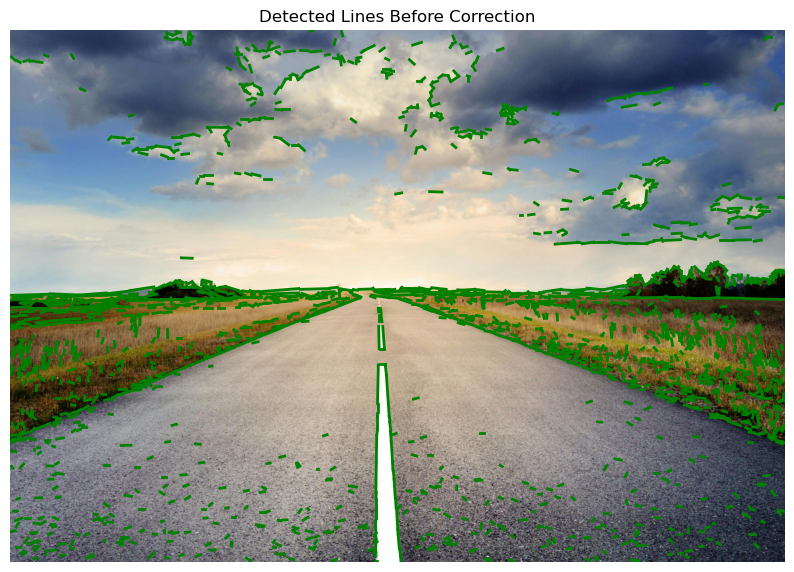

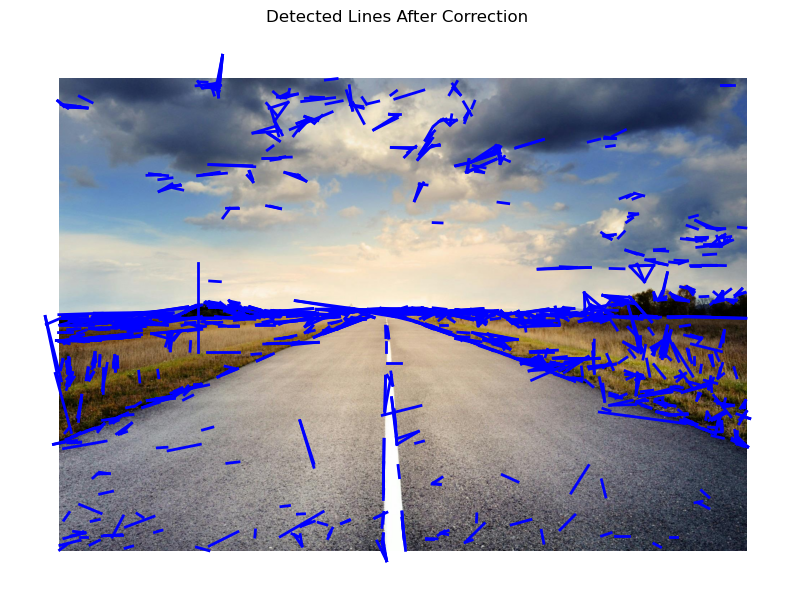

C:\Users\user\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


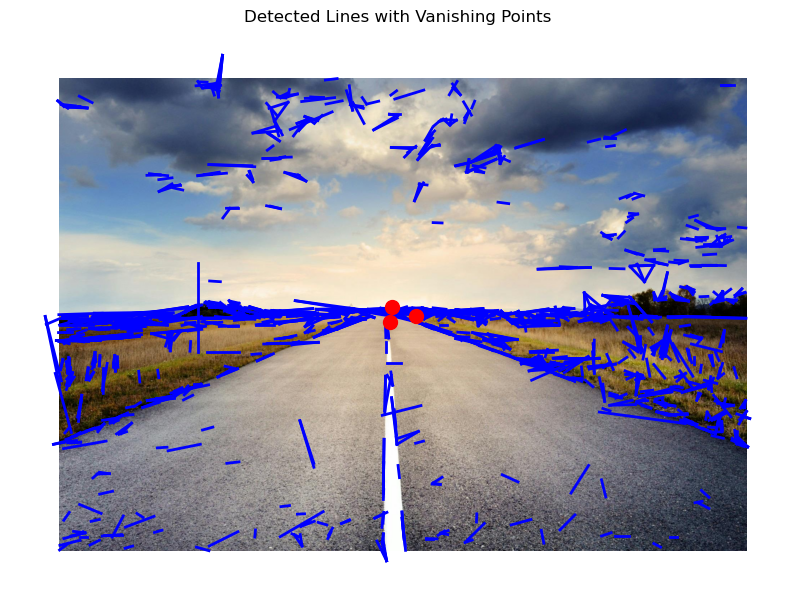

In [79]:
process_image2('./Images/simple_road.jpg')

Cette méthode rend un bon résultat pour l’image 1, mais c’est aussi l’image la plus simple. Passons à l’image 2.

# 6.8.2 - Image 2

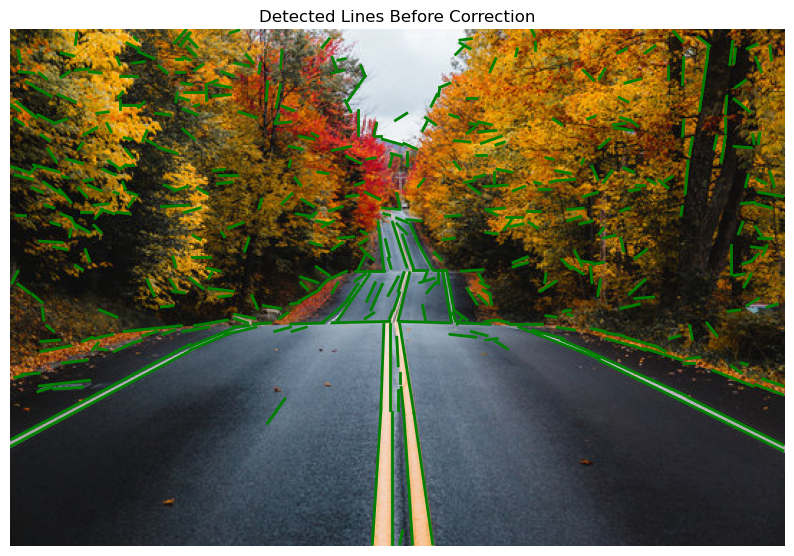

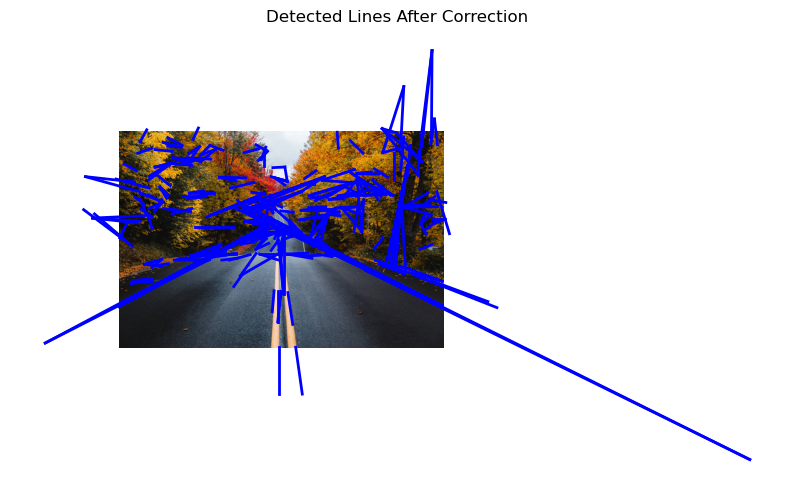

C:\Users\user\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\user\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(


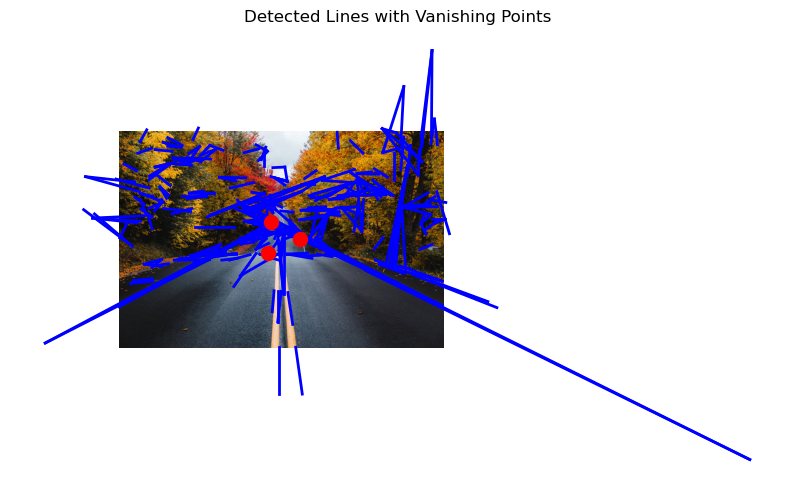

In [80]:
process_image2('./Images/curved_road.jpg')

Ce résultat est consistant avec les autres résultats obtenus pour l’image 2. Avec cette méthode, le point de fuite semble être plus centré ce qui est mieux qu’avant.

# 6.8.3 - Image 3

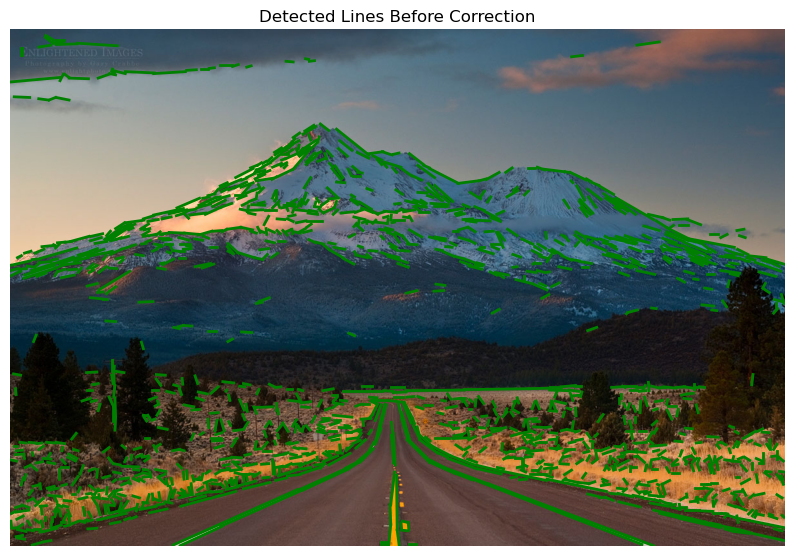

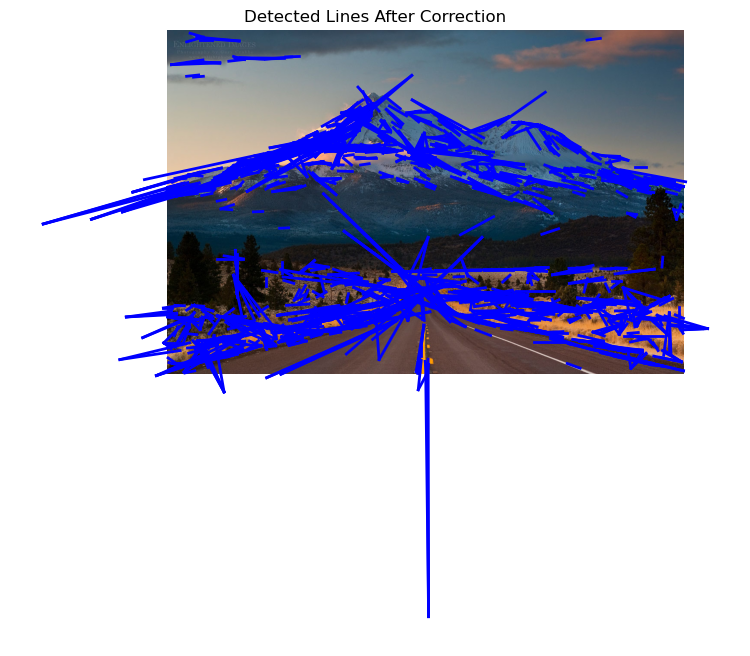

C:\Users\user\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


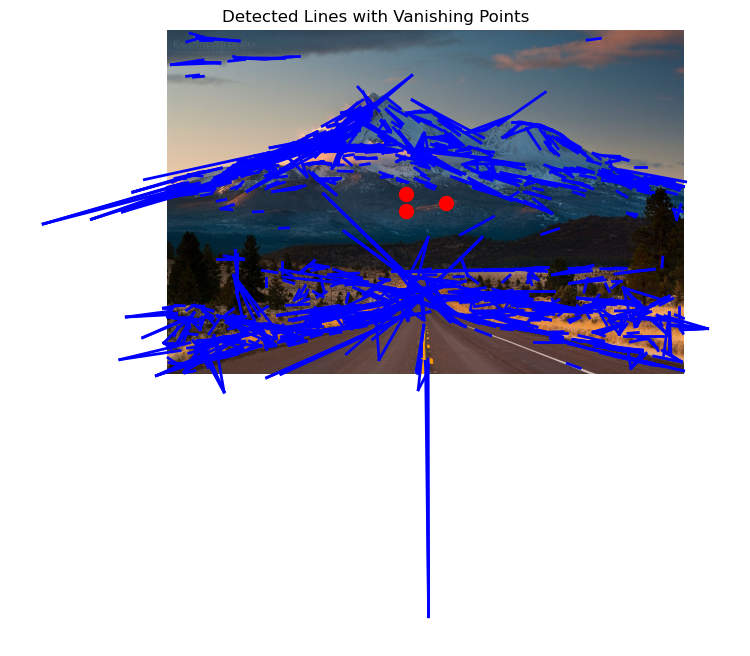

In [81]:
process_image2('./Images/mountain_road.jpg')

Ce résultat est similaire a celui obtenu avant la segmentation. Essayons la méthode d’optimisation des lignes du papier mais avec l’image 3 segmentée.

# 6.8.3 bis - Image 3 segmetée

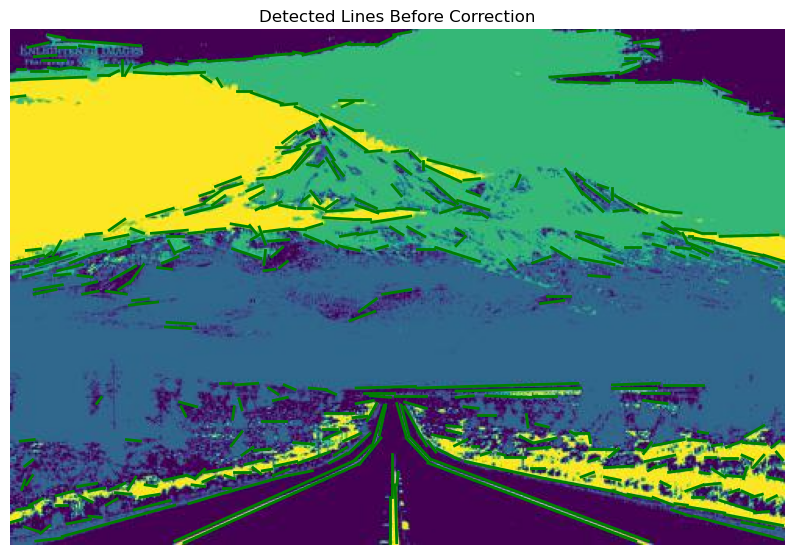

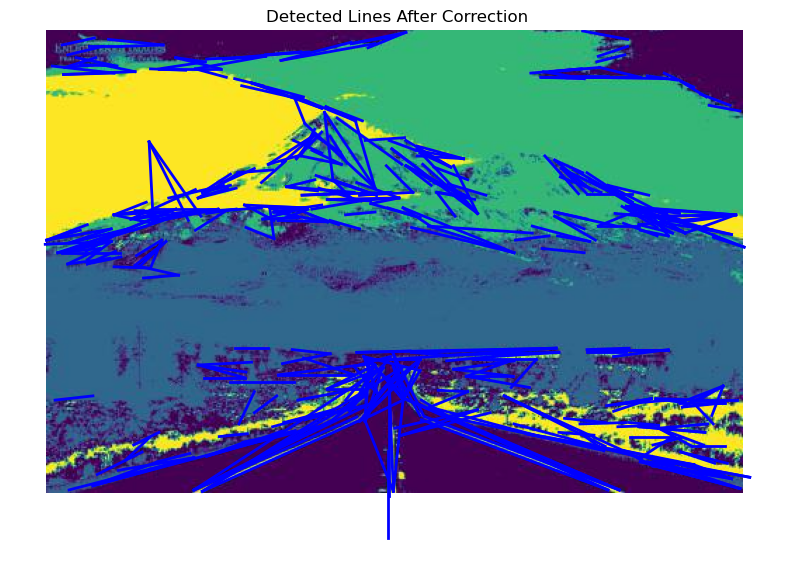

C:\Users\user\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\user\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=2.
  warnings.warn(


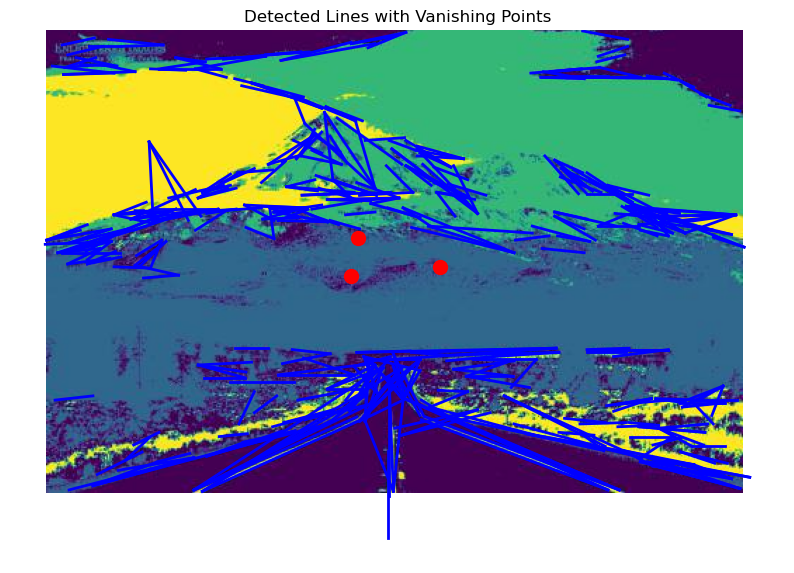

In [82]:
process_image2('./Images_segm/segmented_img3.jpg')

Le résultat ne semble pas avoir changé. Cette nouvelle méthode est pour le moment moins effective pour cette image.

# 6.8.4 - Image 4

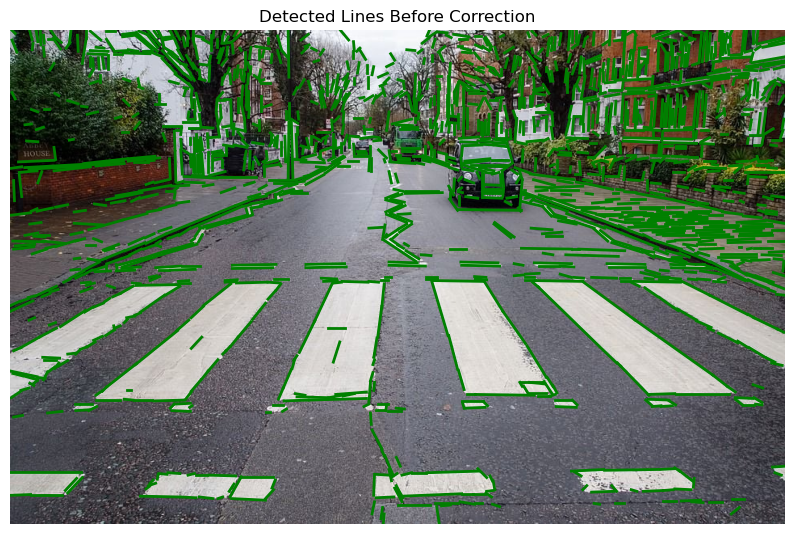

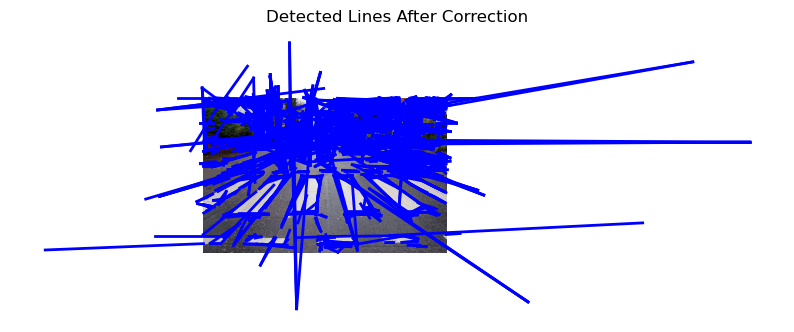

C:\Users\user\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


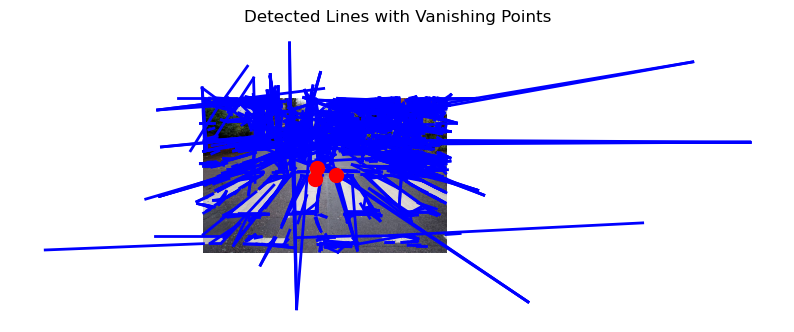

In [83]:
process_image2('./Images/pedestrian_crossing.jpg')

Le résultat n’est pas optimal. Les deux derniers étaient meilleurs.

# 6.8.5 - Image 5

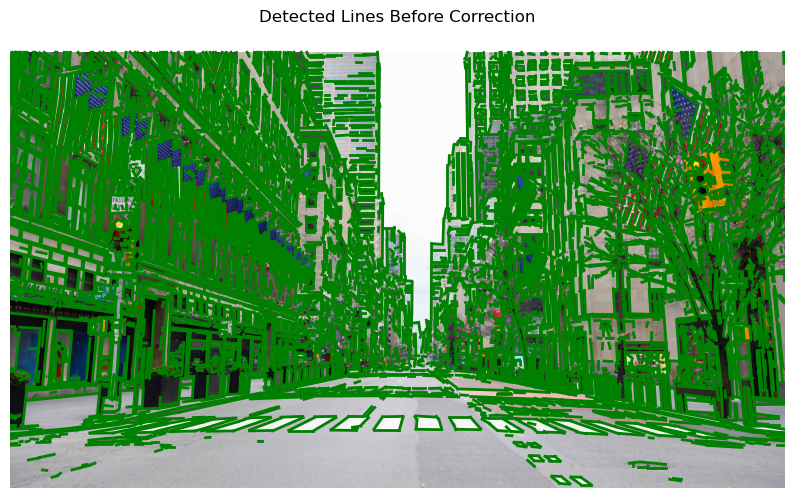

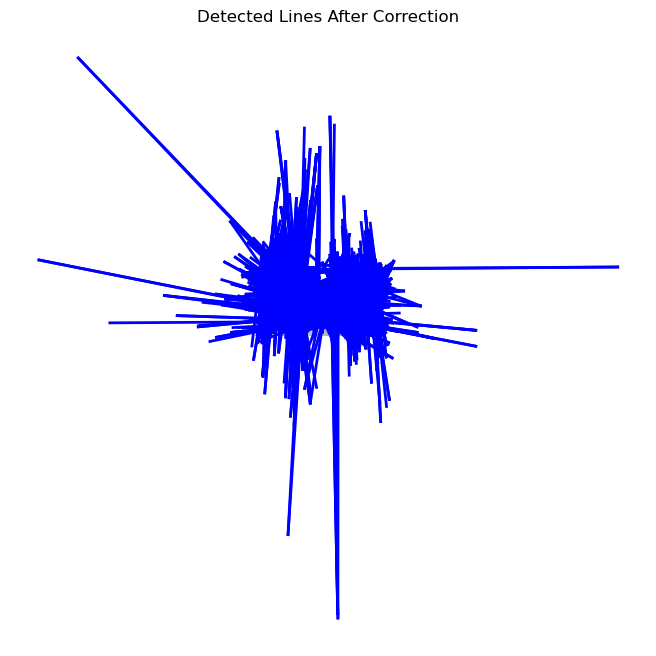

C:\Users\user\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


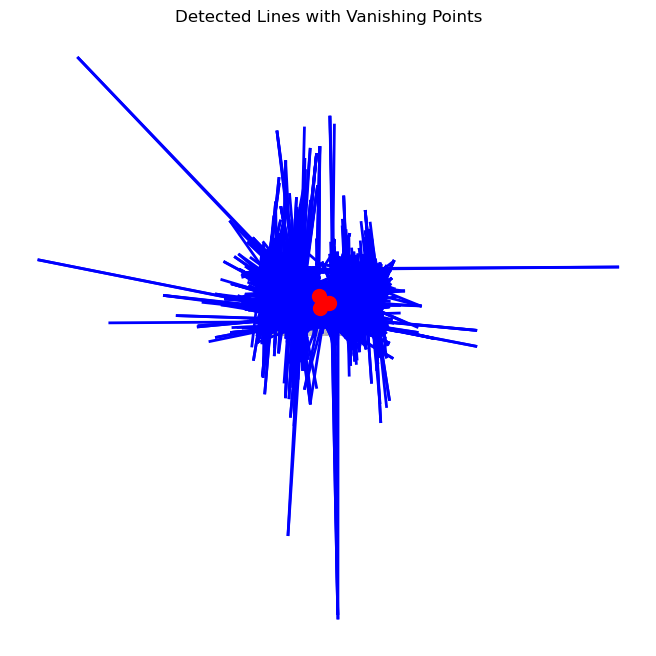

In [84]:
process_image2('./Images/new_york.jpg')

Oui... Bon, essayons cette image de nouveau sans visualiser les lignes.

# 6.8.5 bis Image 5 sans les lignes

In [86]:
def process_image2_bis(image_path):
    # Lire l'image
    image = cv2.imread(image_path)
    if image is None:
        print("Error: Unable to read image.")
        return None

    # Convertion en niveau de gris
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Extraction des lignes
    lines = line_extraction(gray)

    # Visualisation ds lignes detectees
    plt.figure(figsize=(10, 8))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Detected Lines Before Correction')
    for line in lines:
        x1, y1, x2, y2 = line[0]
        plt.plot([x1, x2], [y1, y2], color='green', linewidth=2)
    plt.axis('off')
    plt.show()

    # Line Set Optimization
    correct_line_slope(lines, threshold_distance=10)
    lines = connect_broken_lines(lines, threshold_distance=10)
    lines = remove_short_lines(lines, min_length=20)

    # Visualiser les lignes détectées après correction
    plt.figure(figsize=(10, 8))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Detected Lines After Correction')
    for line in lines:
        x1, y1, x2, y2 = line[0]
        plt.plot([x1, x2], [y1, y2], color='blue', linewidth=2)
    plt.axis('off')
    plt.show()

    # Convertir les lignes en tableau numpy
    lines_np = np.array(lines)

    # Clustering
    num_clusters = 3
    labels = clustering(lines_np, num_clusters)

    # Point de fuite estimé
    vanishing_points = estimate_vanishing_point(lines_np, labels, image)

    # Visualiser les lignes détectées et les points de fuite
    plt.figure(figsize=(10, 8))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Detected Lines with Vanishing Points')
    for point in vanishing_points:
        # S'assurer que le point de fuite est dans les limites de l'image
        vp_x, vp_y = point
        vp_x = max(0, min(vp_x, image.shape[1]))  # Rogner les coordonnées x à la largeur de l'image
        vp_y = max(0, min(vp_y, image.shape[0]))  # Rogner les coordonnées y à la hauteur de l'image

        plt.plot(vp_x, vp_y, 'ro', markersize=10)  # Tracer des points rouges pour les points de fuite
    plt.axis('off')
    plt.show()


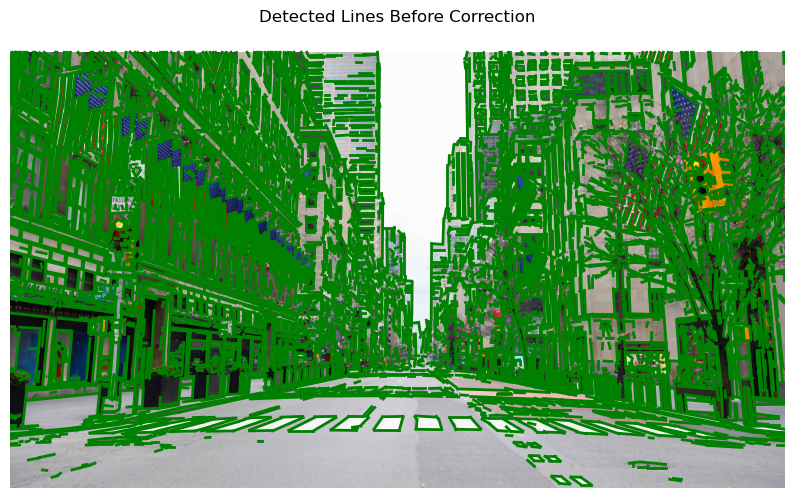

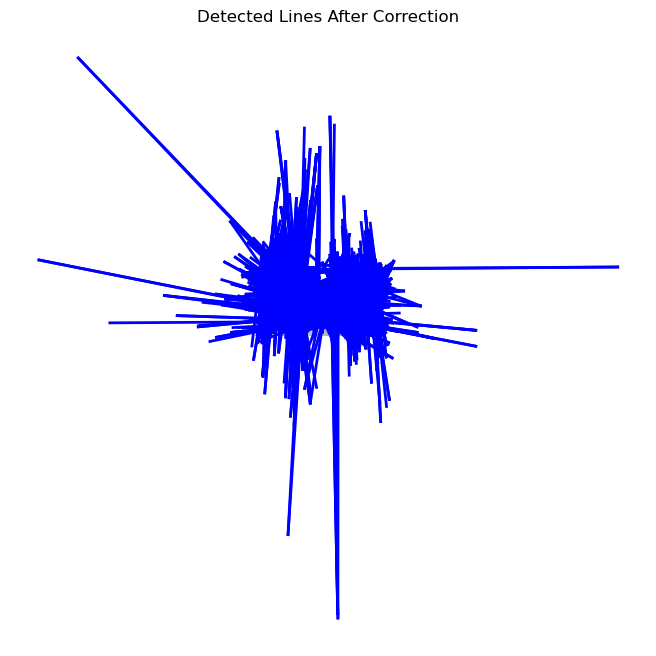

C:\Users\user\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


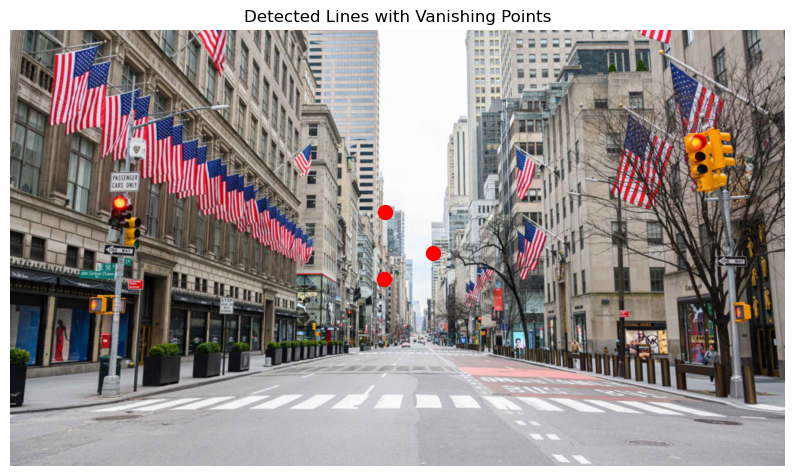

In [87]:
process_image2_bis('./Images/new_york.jpg')

Le résultat ici aussi n’est pas bon, mais vu le nombre de lignes identifiées, ce n’est pas inattendu. 

# 6.8.6 - Image 6

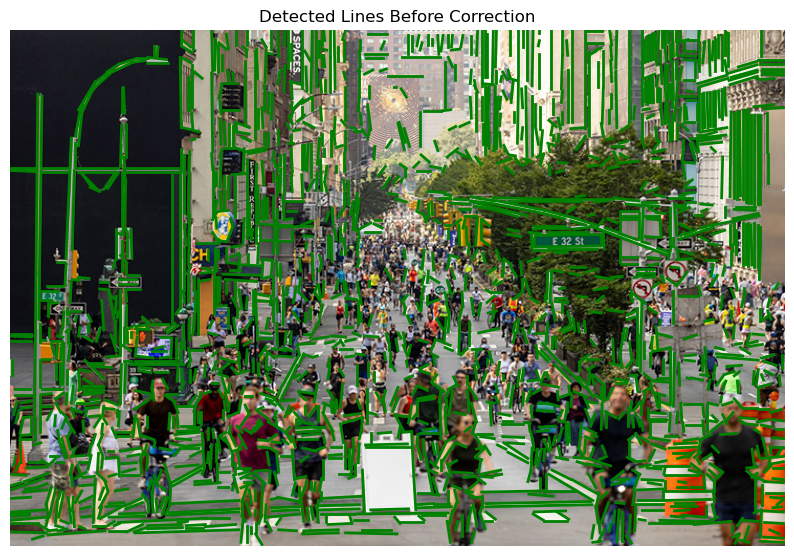

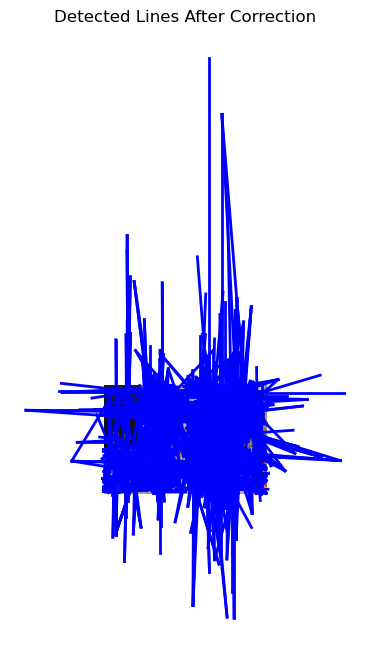

C:\Users\user\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


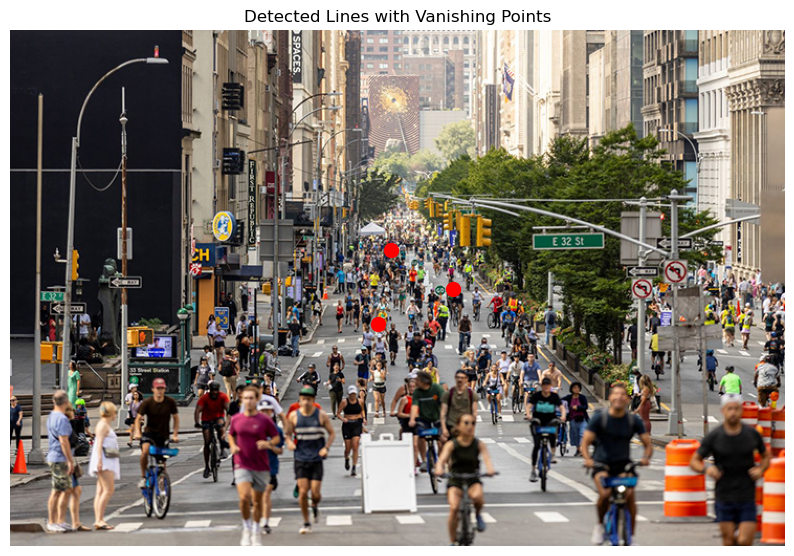

In [88]:
process_image2_bis('./Images/new_york_crowd.jpg')

Pour l’image 6, le résultat est légèrement mieux que ceux obtenus avant. Il n’est pas parfait mais considérant la quantité d’objet dans cette image… 

# 6.9 - Analyse des résultats

Cette méthode d'optimisation peut produire des résultats sous-optimaux pour plusieurs raisons. 

Tout d'abord, l'extraction des lignes peut être influencée par le bruit dans l'image ou les variations d'éclairage, ce qui peut entraîner la détection de segments de lignes incorrects ou la perte d'informations sur la longueur des segments de lignes réels.

De plus, l'algorithme d'optimisation des ensembles de lignes peut ne pas toujours réussir à corriger les pentes des segments de lignes de manière optimale, en particulier dans les cas où les lignes sont fortement déviées de leur trajectoire d'origine. Il est possible que cette methode **associe de mauvaises lignes entre elles** changant la position des points auxquels elles pointaient.

En outre, la détection des points de fuite à partir de l'intersection des lignes peut être sensible aux valeurs aberrantes, ce qui peut conduire à des résultats inexacts, surtout dans les cas où il y a **beaucoup de lignes** dans l'image ou lorsque les lignes sont mal alignées. Il aurait été peut etre mieux de **filtrer les lignes trop courtes avant d'appliquer cette methode** afain de reduire le nombre de lignes.

De plus, la méthode de clustering utilisée peut ne pas toujours regrouper les lignes de manière optimale, ce qui peut entraîner une mauvaise estimation du point de fuite.

# 7 - Pistes d'amelioration

Un axe d'amélioration envisagé concerne l'optimisation des paramètres des algorithmes de détection. En ajustant ces paramètres de manière fine, il est possible d'améliorer la précision et la stabilité de la détection des points de fuite.

De meme optimiser les parametres des clustering est aussi important, peut etre faire plusieurs essais et opter pour les parameter avec les resultats les plus prometteurs.

Une autre piste d'amélioration concerne l'intégration de techniques d'apprentissage automatique. Développer des modèles de réseaux de neurones convolutifs (CNN) adaptés à la détection de points de fuite dans les images de routes pourraient amélioration significative des performances par rapport aux approches traditionnelles.

Une piste d'amélioration prometteuse consisterait à explorer l'incorporation de méthodes de géométrie projective pour une modélisation plus précise de la perspective dans les images de route. Cette approche pourrait permettre d'améliorer la précision de la détection des points de fuite en prenant en compte de manière plus fidèle les propriétés géométriques des scènes routières.

De plus, il serait pertinent d'envisager la validation de ces améliorations proposées sur un ensemble de données diversifié, plus exhaustive avec des annotations. Tester les algorithmes améliorés sur une variété d'images de routes réelles permettrait d'évaluer leur efficacité dans des conditions variables et d'identifier les domaines où des ajustements supplémentaires pourraient être nécessaires.

# 8 - Conclusion

Dans ce rapport, nous avons exploré différentes approches pour détecter les points de fuite dans des images de routes, une tâche essentielle pour de nombreuses applications, notamment la navigation assistée et les systèmes d'aide à la conduite. Nous avons débuté par la détection de lignes dans les images, en utilisant l'algorithme LSD (Line Segment Detector) de OpenCV, suivi de l'identification des intersections entre ces lignes pour estimer les points de fuite.

Ensuite, nous avons examiné l'effet de la segmentation d'image sur la détection des points de fuite, en utilisant des techniques telles que l'extraction de caractéristiques de couleur et le clustering avec l'algorithme K-means. Nous avons observé que la segmentation peut améliorer la précision de la détection dans certains cas, mais peut également introduire des défis supplémentaires, notamment la sensibilité aux valeurs aberrantes.

Nous avons également exploré une méthode d'optimisation des lignes basée sur un papier de recherche ecrit par Xiaoyun An en 2021, qui propose des techniques pour corriger les pentes des lignes, connecter les segments de lignes brisées et estimer les points de fuite de manière plus robuste. Cependant, nous avons constaté que cette méthode peut produire des résultats sous-optimaux dans certaines situations, notamment lorsque les lignes sont fortement déviées de leur trajectoire d'origine ou lorsqu'il y a beaucoup de lignes dans l'image.

En résumé, bien que plusieurs approches aient été explorées pour améliorer la détection des points de fuite dans les images de routes, des défis subsistent en raison de la complexité des scènes routières et de la variabilité des conditions d'éclairage et de prise de vue. Des recherches supplémentaires sont nécessaires pour développer des méthodes plus robustes et précises pour cette tâche cruciale dans le domaine de la vision par ordinateur.